In [7]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt

print(tf.__version__)

2.10.1


In [62]:
gpu_available = tf.config.list_physical_devices('GPU')

if gpu_available:
    print("GPU is available.")
    # Additional information about the GPUs
    for gpu in gpu_available:
        print("GPU:", gpu)
else:
    print("No GPU available. Using CPU.")


GPU is available.
GPU: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [63]:
# from google.colab import drive
# drive.mount('/content/drive')


In [6]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
CHANNELS = 3
EPOCHS = 20

In [65]:
# import os
# image_directory_path = 'snakes'
# os.chdir(image_directory_path)

In [16]:
interim_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    'snakes',
    shuffle=True,
    image_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=BATCH_SIZE
)

Found 3719 files belonging to 10 classes.


In [17]:
interim_class_names = interim_dataset.class_names
interim_class_names

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

In [9]:
interim_snake_labels = { 
    0: 'Rat snake', 
    1: 'Cobra', 
    2: 'Indian Python', 
    3: 'Sand Boa', 
    4: 'Hump Nosed Viper', 
    5: 'Whip Snake', 
    6: 'Sri Lankan Krait', 
    7: 'Common Krait', 
    8: 'Russell’s Viper', 
    9: 'Saw-scaled Viper'
}

In [69]:
len(interim_dataset)

233

In [70]:
for image_batch, label_batch in interim_dataset.take(1):
    print(image_batch.shape)
    print(label_batch.numpy())

(16, 256, 256, 3)
[2 3 5 9 4 9 0 4 8 1 2 2 1 7 2 6]


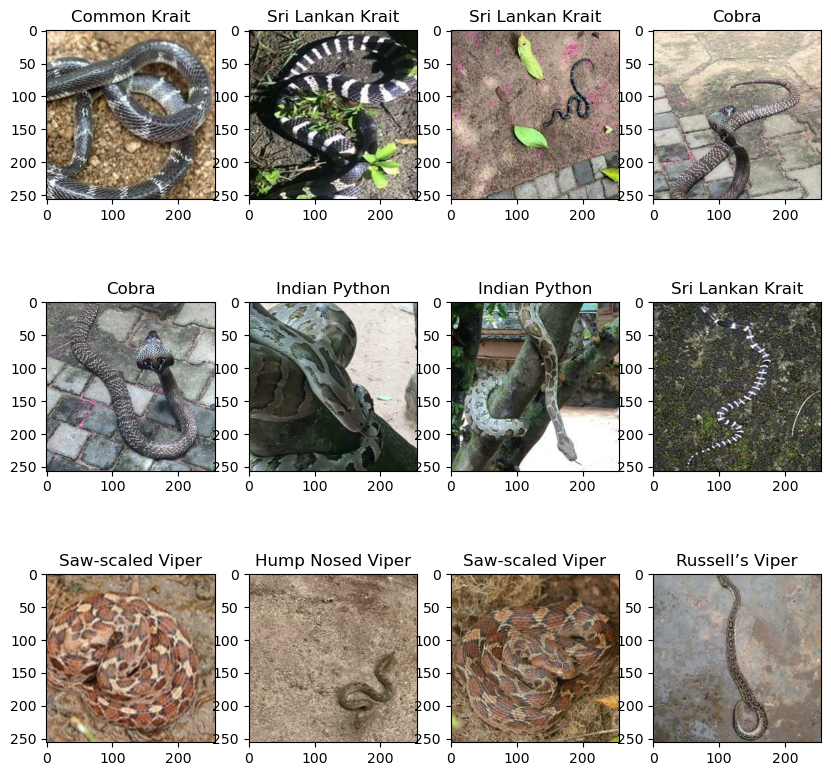

In [71]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,10))
for image_batch, label_batch in interim_dataset.take(1):
    for i in range (12):
        ax = plt.subplot(3,4,i+1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        plt.title(interim_snake_labels[int(interim_class_names[label_batch[i]])])

In [72]:
train_ds = interim_dataset.take(133)
print(len(train_ds))
test_ds = interim_dataset.skip(133)
# print(len(test_ds))
val_ds = test_ds.take(60)
print(len(val_ds))
test_ds = test_ds.skip(60)
print(len(test_ds))

133
60
40


In [73]:
train_ds = train_ds.cache().shuffle(100).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds = val_ds.cache().shuffle(100).prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds = test_ds.cache().shuffle(100).prefetch(buffer_size=tf.data.AUTOTUNE)

In [74]:
data_augmentation = tf.keras.Sequential([
    layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
    layers.experimental.preprocessing.RandomRotation(0.2),
    layers.experimental.preprocessing.RandomFlip(mode="horizontal"),
    layers.experimental.preprocessing.RandomZoom(height_factor=0.2, width_factor=0.2)
])

resize_and_rescale = tf.keras.Sequential([
    layers.experimental.preprocessing.Resizing(IMAGE_SIZE,IMAGE_SIZE),
    layers.experimental.preprocessing.Rescaling(1.0/255)
])

In [75]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
import datetime

In [76]:
callbacks = [EarlyStopping(monitor='val_loss', patience=5, verbose=1),
                ModelCheckpoint('checkpoint_model.hdf5',save_best_only=True)]

In [77]:
model = VGG16(
    include_top=False,
    weights="imagenet",
    input_shape=(256, 256, 3),
    classes=len(interim_class_names),
)

In [78]:
model.trainable=False
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
dense1 = tf.keras.layers.Dense(512, activation='relu')
#dense2 = tf.keras.layers.Dense(256, activation='relu')
# dense3 = tf.keras.layers.Dense(128, activation='relu')
dense4 = tf.keras.layers.Dense(64, activation='relu')
dense5 = tf.keras.layers.Dense(64, activation='relu')
prediction_layer = tf.keras.layers.Dense(len(interim_class_names),activation='softmax')

In [79]:
interim_model = tf.keras.Sequential([
  model,
  global_average_layer,
  dense1,
  #dense2,
  # dense3,
  dense4,
  dense5,
  prediction_layer
])

In [80]:
interim_model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 global_average_pooling2d_2   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_8 (Dense)             (None, 512)               262656    
                                                                 
 dense_9 (Dense)             (None, 64)                32832     
                                                                 
 dense_10 (Dense)            (None, 64)                4160      
                                                                 
 dense_11 (Dense)            (None, 10)                650       
                                                      

In [81]:
interim_model.compile(
    optimizer='adam',
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics = ['accuracy']
)

In [82]:
interim_history = interim_model.fit(
    train_ds,
    epochs = EPOCHS,
    batch_size=BATCH_SIZE,
    verbose=1,
    validation_data = val_ds
)

Epoch 1/20
133/133 [==============================] - 37s 269ms/step - loss: 0.9297 - accuracy: 0.7138 - val_loss: 0.6870 - val_accuracy: 0.8073
Epoch 2/20
133/133 [==============================] - 35s 263ms/step - loss: 0.3381 - accuracy: 0.8853 - val_loss: 0.4220 - val_accuracy: 0.8594
Epoch 3/20
133/133 [==============================] - 35s 267ms/step - loss: 0.1904 - accuracy: 0.9347 - val_loss: 0.3871 - val_accuracy: 0.8813
Epoch 4/20
133/133 [==============================] - 37s 275ms/step - loss: 0.1331 - accuracy: 0.9568 - val_loss: 0.4791 - val_accuracy: 0.8656
Epoch 5/20
133/133 [==============================] - 35s 265ms/step - loss: 0.0885 - accuracy: 0.9718 - val_loss: 0.3808 - val_accuracy: 0.8979
Epoch 6/20
133/133 [==============================] - 35s 265ms/step - loss: 0.0736 - accuracy: 0.9774 - val_loss: 0.6209 - val_accuracy: 0.8552
Epoch 7/20
133/133 [==============================] - 35s 265ms/step - loss: 0.0537 - accuracy: 0.9845 - val_loss: 0.3703 - val_ac

In [83]:
scores = interim_model.evaluate(test_ds)

40/40 [==============================] - 9s 181ms/step - loss: 0.5539 - accuracy: 0.9160


In [84]:
print(interim_history)
print(interim_history.params)
print(interim_history.history.keys())

{'verbose': 1, 'epochs': 20, 'steps': 133}
dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


In [85]:
from tensorflow.keras.utils import plot_model
from IPython.display import Image
plot_model(interim_model, to_file='interim_vgg_draft.png', show_shapes=True,show_layer_names=True)
# Image(filename='interim_vgg_draft.png')

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [3]:
from tensorflow.keras.models import load_model

In [87]:
interim_model.save("final_vgg_09.h5")

In [5]:
# from tensorflow.keras.models import load_model
# from tensorflow.keras.models import load_model
from tensorflow.keras.models import load_model
loaded_model = load_model("finalmodel06.h5")

In [89]:
loaded_model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 global_average_pooling2d_2   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_8 (Dense)             (None, 512)               262656    
                                                                 
 dense_9 (Dense)             (None, 64)                32832     
                                                                 
 dense_10 (Dense)            (None, 64)                4160      
                                                                 
 dense_11 (Dense)            (None, 10)                650       
                                                      

In [90]:
def learning_curve(model_fit, key='accuracy', ylim=(0, 1.01)):
    plt.figure(figsize=(12,6))
    plt.plot(model_fit.history[key])
    plt.plot(model_fit.history['val_' + key])
    plt.title('Learning Curve')
    plt.ylabel(key.title())
    plt.xlabel('Epoch')
    plt.ylim(ylim)
    plt.legend(['train', 'val'], loc='best')
    plt.show()

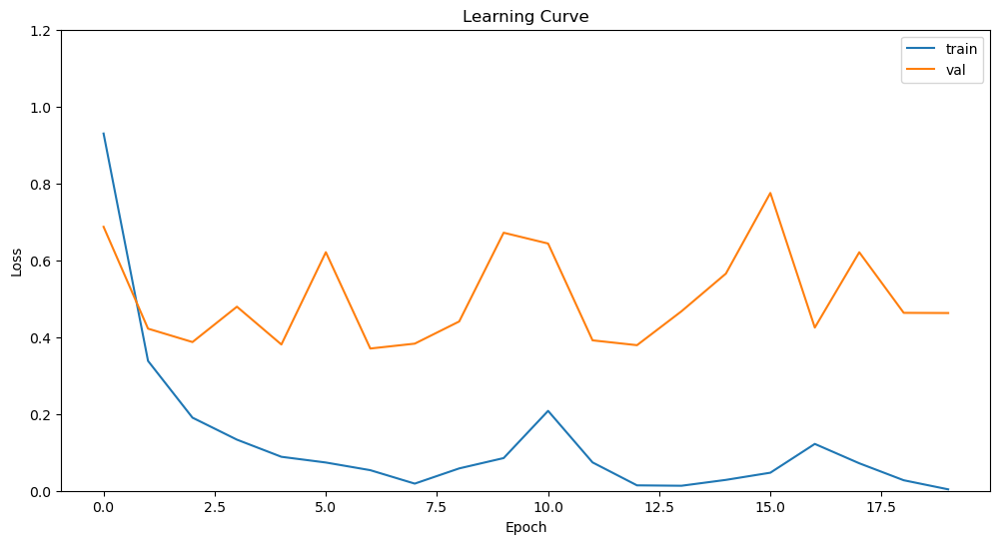

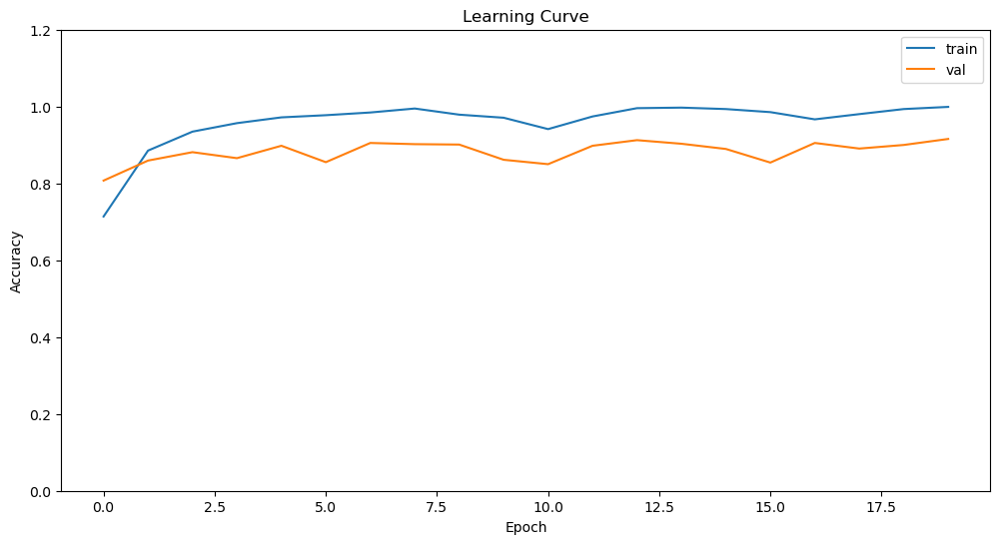

In [91]:
learning_curve(interim_history,'loss', ylim=(0,1.2))
learning_curve(interim_history, 'accuracy', ylim=(0,1.2))

In [92]:
test_loss, test_acc = interim_model.evaluate(test_ds, steps=len(test_ds), verbose=1)
print('Loss: %.3f' % (test_loss * 100.0))
print('Accuracy: %.3f' % (test_acc * 100.0))

40/40 [==============================] - 7s 180ms/step - loss: 0.5539 - accuracy: 0.9160
Loss: 55.388
Accuracy: 91.601


In [93]:
import numpy as np
y_pred = []
y_true = []


for image_batch, label_batch in test_ds:

   y_true.append(label_batch)

   preds = model.predict(image_batch)

   y_pred.append(np.argmax(preds, axis = - 1))


correct_labels = tf.concat([item for item in y_true], axis = 0)

predicted_labels = tf.concat([item for item in y_pred], axis = 0)

1/1 [==============================] - 0s 43ms/step


In [94]:
import numpy as np

predictions = np.argmax(interim_model.predict(test_ds), axis=1)
labels = interim_dataset.class_names

predicted_class_names = [labels[prediction] for prediction in predictions]
print(predicted_class_names)
print(predictions)
print(labels)

40/40 [==============================] - 7s 178ms/step
['6', '9', '6', '6', '9', '0', '1', '9', '8', '6', '6', '8', '5', '2', '9', '8', '9', '2', '5', '7', '8', '1', '8', '8', '6', '6', '7', '8', '4', '3', '3', '6', '2', '6', '9', '4', '6', '1', '9', '8', '7', '6', '2', '7', '9', '4', '4', '9', '3', '0', '5', '6', '5', '4', '8', '4', '9', '1', '1', '1', '7', '2', '1', '9', '9', '4', '8', '4', '9', '6', '2', '6', '0', '4', '1', '3', '7', '1', '1', '0', '8', '6', '8', '5', '4', '1', '8', '7', '0', '0', '6', '8', '8', '1', '8', '0', '3', '8', '8', '5', '5', '4', '6', '7', '3', '9', '4', '3', '6', '8', '1', '4', '5', '5', '8', '6', '3', '1', '1', '8', '6', '1', '4', '2', '9', '8', '8', '8', '9', '2', '9', '6', '2', '8', '3', '3', '8', '9', '6', '8', '4', '3', '8', '9', '8', '3', '8', '9', '2', '5', '3', '7', '0', '6', '2', '1', '5', '0', '5', '3', '5', '9', '2', '7', '5', '5', '3', '1', '1', '0', '9', '8', '8', '5', '2', '4', '8', '4', '5', '5', '1', '3', '1', '4', '6', '5', '6', '8', '8',

first image to predict
actual label: 8
1/1 [==============================] - 0s 176ms/step
predicted label: 8


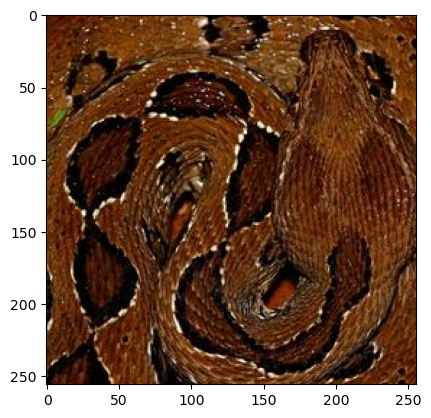

In [95]:
import numpy as np
for images_batch, labels_batch in test_ds.take(1):

    first_image = images_batch[0].numpy().astype('uint8')
    first_label = labels_batch[0].numpy()

    print("first image to predict")
    plt.imshow(first_image)
    print("actual label:",interim_class_names[first_label])

    batch_prediction = loaded_model.predict(images_batch)
    print("predicted label:",interim_class_names[np.argmax(batch_prediction[0])])

In [11]:
def predict(MODEL, img):
   img_array = tf.keras.preprocessing.image.img_to_array(images[i].numpy())
   img_array = tf.expand_dims(img_array, 0)

   predictions = MODEL.predict(img_array)

   predicted_class = np.argmax(predictions[0])
   confidence = round(100 * (np.max(predictions[0])), 2)
   return predicted_class, confidence

1/1 [==============================] - ETA: 0s

C:\Users\Kimuthu Kisal\AppData\Local\Temp\ipykernel_5448\718562800.py:9: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(3, 3, i + 1)


1/1 [==============================] - 0s 40ms/step


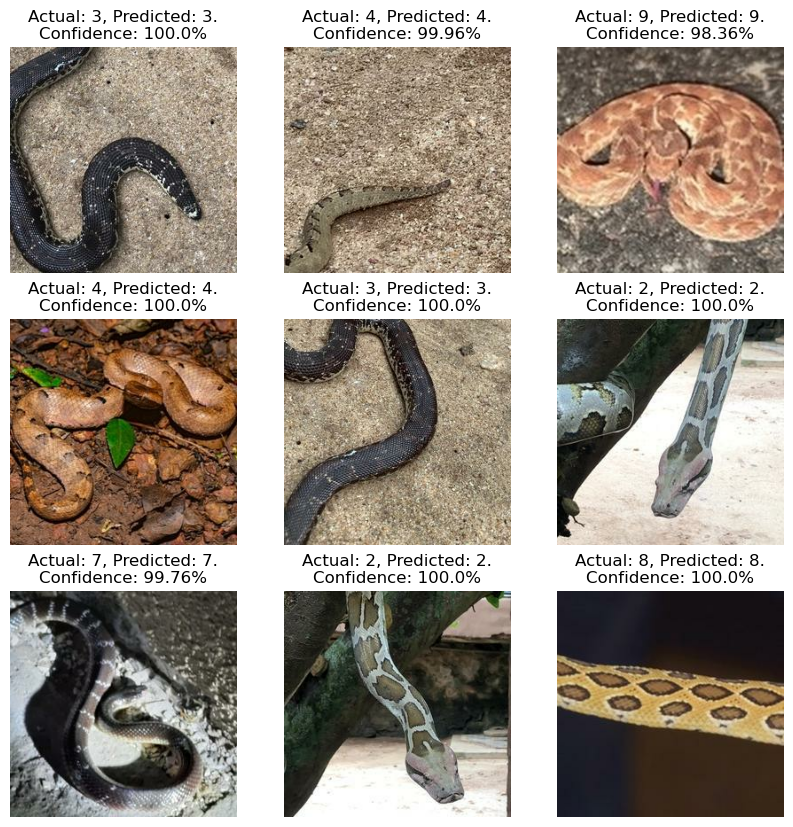

In [97]:
import numpy as np
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
plt.axis('off')

for images, labels in test_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))

        predicted_class, confidence = predict(loaded_model, images[i].numpy())
        predicted_class_name = interim_class_names[predicted_class]
        actual_class = interim_class_names[labels[i]]

        plt.title(f"Actual: {actual_class}, Predicted: {predicted_class_name}.\nConfidence: {confidence}%")
        plt.axis('off')

plt.show()

Found 141 files belonging to 1 classes.
1/1 [==============================] - 0s 41ms/step


C:\Users\Kimuthu Kisal\AppData\Local\Temp\ipykernel_10136\1380967969.py:31: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax = plt.subplot(40, 4, i + 1)


1/1 [==============================] - 0s 41ms/step


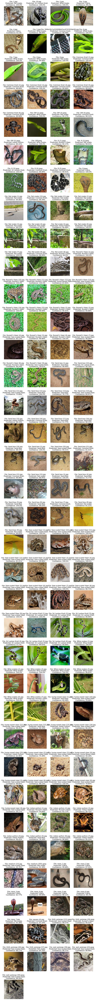

In [18]:
import tensorflow as tf
import numpy as np
from tensorflow import keras
import matplotlib.pyplot as plt
import os

test_snake_ds_final = tf.keras.preprocessing.image_dataset_from_directory(
    "mix",
    shuffle = False,
    image_size = (IMAGE_SIZE,IMAGE_SIZE),
    batch_size = BATCH_SIZE*9
)

# Define a function to get the file name
def get_file_name(image_path):
    # Use os.path.basename to extract only the file name from the path
    return os.path.basename(image_path)

# Create a list to store file names
file_names = []
for images, labels in test_snake_ds_final:
    for image_path in test_snake_ds_final.file_paths:
        file_name = get_file_name(image_path)
        file_names.append(file_name)
    
plt.figure(figsize=(12, 15*10))
plt.axis('off')

for images, labels in test_snake_ds_final:
    for i in range(141):
        ax = plt.subplot(40, 4, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        
        predicted_class, confidence = predict(loaded_model, images[i].numpy())
        actual_class = interim_class_names[labels[i]] 
        
#         plt.title(f"Actual: {actual_class}, Predicted: {predicted_class}.\n Confidence: {confidence}%")
        plt.title(f"File: {file_names[i]} \n Predicted: {interim_snake_labels[int(predicted_class)]}.\n Confidence: {confidence}%")
        plt.axis('off')
# plt.axis("off")